<a href="https://colab.research.google.com/github/hkchi-pham/study-it/blob/main/python/ml_training_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
pip install ydata-profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.7/395.7 kB 10.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 13.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 27.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 69.3 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=7e79ad6543bd4280b87aab43c4c064af8ef1f4899660aaa38df23575ef36d9e4
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin


In [ ]:
X_train = pd.read_csv('X_train.csv')
y_train = pd.read_csv('y_train.csv')
X_pred = pd.read_csv('X_private_test.csv')

X_train.shape, y_train.shape, X_pred.shape

((2886, 22), (2886, 1), (2800, 22))

In [ ]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2886 entries, 0 to 2885
Data columns (total 22 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   f1      2886 non-null   float64
 1   f2      2742 non-null   float64
 2   f3      2886 non-null   float64
 3   f4      2886 non-null   float64
 4   f5      2742 non-null   float64
 5   f6      2886 non-null   float64
 6   f7      2886 non-null   float64
 7   f8      2886 non-null   float64
 8   f9      2886 non-null   float64
 9   f10     2742 non-null   float64
 10  f11     2886 non-null   float64
 11  f12     2886 non-null   float64
 12  f13     2886 non-null   float64
 13  f14     2886 non-null   float64
 14  f15     2886 non-null   float64
 15  f16     2886 non-null   float64
 16  f17     2886 non-null   float64
 17  f18     2886 non-null   float64
 18  f19     2886 non-null   float64
 19  f20     2886 non-null   float64
 20  f21     1732 non-null   float64
 21  f22     2021 non-null   float64
dtype

In [ ]:
X_pred.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2800 entries, 0 to 2799
Data columns (total 22 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   f1      2800 non-null   float64
 1   f2      2800 non-null   float64
 2   f3      2800 non-null   float64
 3   f4      2800 non-null   float64
 4   f5      2800 non-null   float64
 5   f6      2800 non-null   float64
 6   f7      2800 non-null   float64
 7   f8      2800 non-null   float64
 8   f9      2800 non-null   float64
 9   f10     2800 non-null   float64
 10  f11     2800 non-null   float64
 11  f12     2800 non-null   float64
 12  f13     2800 non-null   float64
 13  f14     2800 non-null   float64
 14  f15     2800 non-null   float64
 15  f16     2800 non-null   float64
 16  f17     2800 non-null   float64
 17  f18     2800 non-null   float64
 18  f19     2800 non-null   float64
 19  f20     2800 non-null   float64
 20  f21     2800 non-null   float64
 21  f22     2800 non-null   float64
dtype

In [ ]:
from ydata_profiling import ProfileReport

profile = ProfileReport(X_train, title="Profiling Report")

profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 22/22 [00:00<00:00, 43.82it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#missing value

X_train_null = X_train.columns[X_train.isnull().any()]
for col in X_train_null:
    print(f"{col} with {X_train[col].isnull().sum()/len(X_train[col]) * 100}")

f2 with 4.98960498960499
f5 with 4.98960498960499
f10 with 4.98960498960499
f21 with 39.98613998613998
f22 with 29.972279972279974


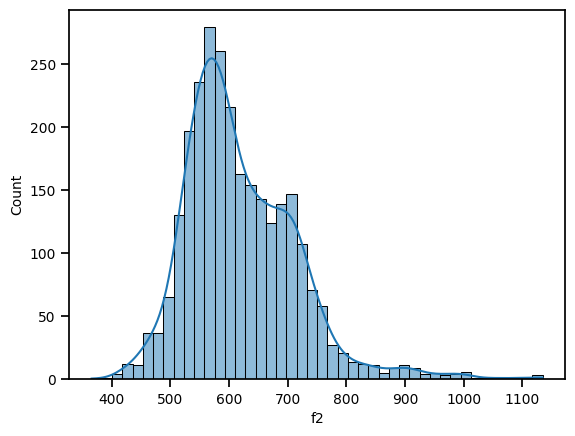

In [ ]:


sns.histplot(X_train['f2'], kde=True)
plt.show()

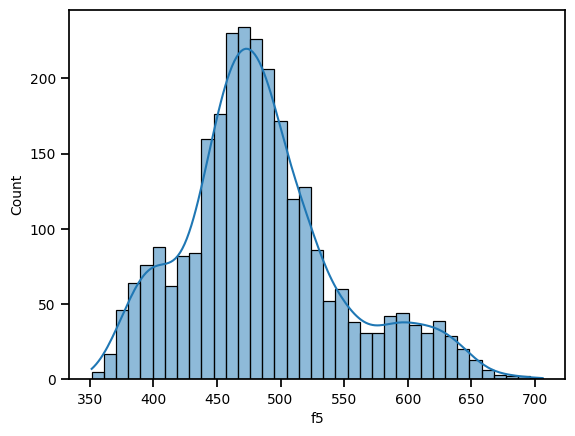

In [ ]:


sns.histplot(X_train['f5'], kde=True)
plt.show()

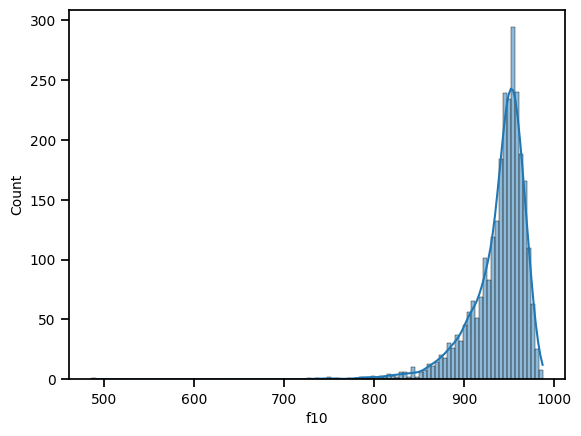

In [ ]:


sns.histplot(X_train['f10'], kde=True)
plt.show()

In [ ]:
X_train['f2'].fillna(X_train['f2'].median(), inplace=True)
X_train['f5'].fillna(X_train['f5'].median(), inplace=True)
X_train['f10'].fillna(X_train['f10'].median(), inplace=True)




<ipython-input-3-5f8e79f8a6a3>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_train['f2'].fillna(X_train['f2'].median(), inplace=True)
<ipython-input-3-5f8e79f8a6a3>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', 

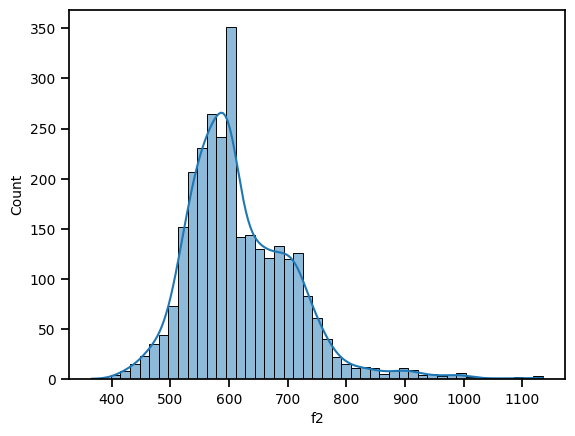

In [ ]:
sns.histplot(X_train['f2'], kde=True)
plt.show()

In [ ]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=100, weights="uniform")
missing_cols = ['f21','f22']
X_train_missing = X_train[missing_cols]
X_train_missing = imputer.fit_transform(X_train_missing)
X_train_missing = pd.DataFrame(X_train_missing, columns=missing_cols)

X_train.update(X_train_missing)


In [ ]:
X_train.drop(['f21','f22'], axis=1, inplace=True)
X_pred.drop(['f21','f22'], axis=1, inplace=True)

In [ ]:
from sklearn.mixture import GaussianMixture
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
imputer = IterativeImputer(estimator=GaussianMixture(n_components=3, random_state=42))
missing_cols = ['f21','f22']
X_train_missing = X_train[missing_cols]
X_train_missing = imputer.fit_transform(X_train_missing)
X_train_missing = pd.DataFrame(X_train_missing, columns=missing_cols)

X_train.update(X_train_missing)


In [ ]:
X_train.isnull().sum()

,0
f1,0
f2,0
f3,0
f4,0
f5,0
f6,0
f7,0
f8,0
f9,0
f10,0


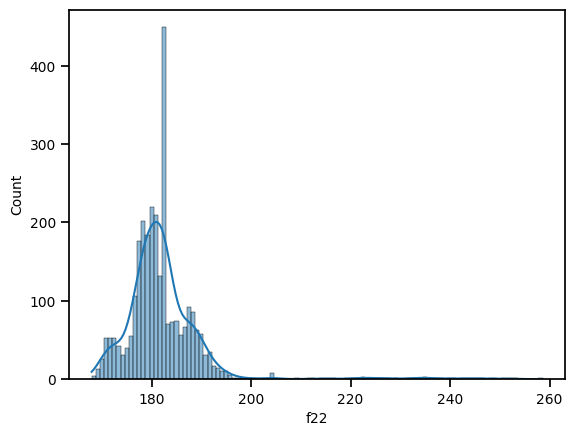

In [ ]:
sns.histplot(X_train['f22'], kde=True)
plt.show()

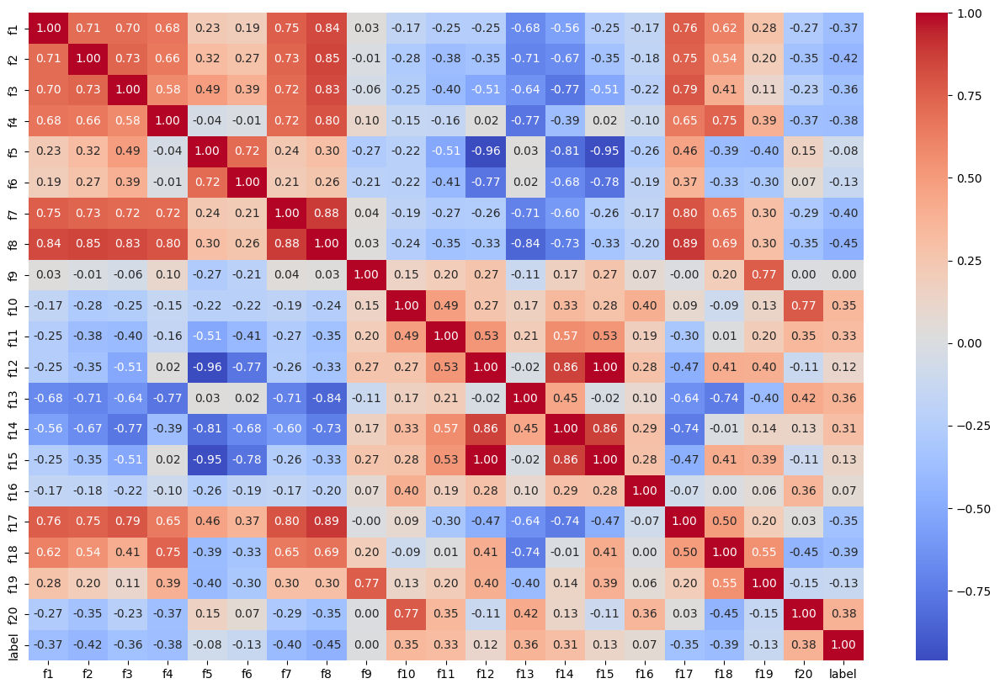

In [ ]:
df = pd.concat([X_train, y_train], axis=1)
corr = df.corr()
plt.figure(figsize=(16, 10))
sns.heatmap(corr, annot=True, fmt='.2f', cmap='coolwarm')
plt.show()

In [ ]:
from xgboost import XGBClassifier

model = XGBClassifier(n_estimators=100, learning_rate=0.1, random_state=42)
model.fit(X_train, y_train)

feature_importance = model.feature_importances_
importance_df = pd.DataFrame({"Feature": X_train.columns, "Importance": feature_importance}).sort_values(by="Importance", ascending=False)
importance_df

,Feature,Importance
11,f12,0.341719
7,f8,0.260137
13,f14,0.102455
17,f18,0.056703
12,f13,0.032293
16,f17,0.022477
10,f11,0.017110
19,f20,0.017023
9,f10,0.014330
4,f5,0.013662


In [ ]:
col = ['f8','f18','f14','f12','f10','f11','f9','f5']
X_train = X_train[col]
X_pred = X_pred[col]

In [ ]:
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import SelectKBest

mi_scores = mutual_info_classif(X_train, y_train)

k_best = SelectKBest(mutual_info_classif, k=3)
X_selected = k_best.fit_transform(X_train, y_train)
print(X_selected)
selected_mi = pd.DataFrame({'Feature': X_train.columns, 'Mutual Information': mi_scores})
selected_mi = selected_mi.sort_values(by='Mutual Information', ascending=False)
selected_mi


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[159.26645231 185.43135905 609.74810584]
 [181.34744615 152.81580751 503.83337208]
 [145.62707788 184.873547   646.26766028]
 ...
 [154.61835686 241.56527174 789.08274868]
 [174.90483428 142.57731787 495.06609204]
 [190.28004213 161.50761717 507.16842321]]


,Feature,Mutual Information
7,f8,0.835939
13,f14,0.814210
11,f12,0.696090
14,f15,0.696049
4,f5,0.650853
12,f13,0.632970
17,f18,0.609832
16,f17,0.565168
21,f22,0.559671
1,f2,0.507738


In [ ]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier()
selector = RFE(model, n_features_to_select=12)
X_selected = selector.fit_transform(X_train, y_train)


/usr/local/lib/python3.11/dist-packages/sklearn/base.py:1389: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/usr/local/lib/python3.11/dist-packages/sklearn/base.py:1389: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/usr/local/lib/python3.11/dist-packages/sklearn/base.py:1389: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/usr/local/lib/python3.11/dist-packages/sklearn/base.py:1389: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example usi

In [ ]:
col = ['f12','f8','f14','f13','f18','f17','f5','f10','f20']
X_train = X_train[col]
X_pred = X_pred[col]

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
pca = PCA(n_components=12)

X_train_pca = pca.fit_transform(X_train_scaled)




In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score

X_train, X_val, y_train, y_val = train_test_split(X_train_pca, y_train, test_size=0.2, random_state=42)



In [ ]:
model = XGBClassifier(n_estimators=100, learning_rate=0.1, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_val)
f1 = f1_score(y_val, y_pred,average='macro')
print(f"F1 Score: {f1}")

F1 Score: 0.8249387636087394


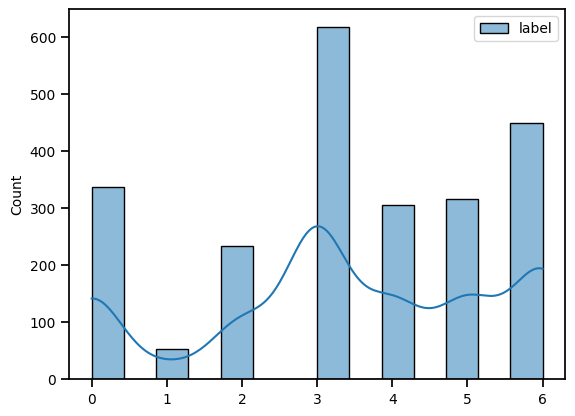

In [ ]:
sns.histplot(y_train, kde=True)
plt.show()

In [ ]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(sampling_strategy={0: 500, 1: 500, 2: 450,4:500,5:525,6: 575}, random_state=42)
X_train,y_train = smote.fit_resample(X_train, y_train)

In [ ]:
pip install openfe


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)


In [ ]:
from scipy.stats import skew
from sklearn.preprocessing import PowerTransformer, QuantileTransformer,StandardScaler

stan = ['f9','f11','f12']
power = ['f5','f8','f10','f18']
quant = ['f14']

for col in stan:
  scaler = StandardScaler()
  X_train[col] = scaler.fit_transform(X_train[[col]])
  X_val[col] = scaler.transform(X_val[[col]])
  X_pred[col] = scaler.transform(X_pred[[col]])
for col in power:
  scaler = PowerTransformer(method='yeo-johnson')
  X_train[col] = scaler.fit_transform(X_train[[col]])
  X_val[col] = scaler.transform(X_val[[col]])
  X_pred[col] = scaler.transform(X_pred[[col]])
for col in quant:
  scaler = QuantileTransformer(output_distribution='normal')
  X_train[col] = scaler.fit_transform(X_train[[col]])
  X_val[col] = scaler.transform(X_val[[col]])
  X_pred[col] = scaler.transform(X_pred[[col]])

In [ ]:
pip install autogluon

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 3.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 8.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.5/259.5 kB 13.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of openxlab to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of openxlab to determine which version is compatible with other requirements. This could take a while.
INFO: This is taking longer than usual. You might need to provide the dependency resolver with stricter constraints to reduce runtime. 

In [ ]:
from autogluon.tabular import TabularPredictor


label = 'label'
df = pd.concat([X_train, y_train], axis=1)
df_val = pd.concat([X_val, y_val], axis=1)
hyperparameters = {

    # =========================
    # 1) LightGBM (GBM)
    # =========================
    "GBM": [
        {  # Variant 1
            "num_boost_round": 1000,
            "num_leaves": 31,
            "learning_rate": 0.05,
            "feature_fraction": 0.8,
            "bagging_fraction": 0.8,
            "bagging_freq": 1,
            "ag_args": {
                "name_suffix": "GBM1"  # appended to the model name
            }
        },
        {  # Variant 2
            "num_boost_round": 3000,
            "num_leaves": 63,
            "learning_rate": 0.02,
            "feature_fraction": 0.7,
            "bagging_fraction": 0.7,
            "bagging_freq": 5,
            "ag_args": {
                "name_suffix": "GBM2"
            }
        }
    ],

    # =========================
    # 2) CatBoost
    # =========================
    "CAT": [
        {  # Variant 1
            "auto_class_weights": "Balanced",
            "iterations": 2000,
            "depth": 6,
            "learning_rate": 0.05,
            "random_strength": 1,
            "bagging_temperature": 0.95,
            "od_type": "Iter",
            "od_wait": 50,
            "ag_args": {
                "name_suffix": "CAT1"
            }
        },
        {  # Variant 2 (deeper)
            "auto_class_weights": "Balanced",
            "iterations": 3000,
            "depth": 8,
            "learning_rate": 0.03,
            "random_strength": 1,
            "bagging_temperature": 1.0,
            "od_type": "Iter",
            "od_wait": 50,
            "ag_args": {
                "name_suffix": "CAT2"
            }
        }
    ],

    # =========================
    # 3) XGBoost
    # =========================
    "XGB": [
        {  # Variant 1
            "n_estimators": 1000,
            "max_depth": 6,
            "learning_rate": 0.05,
            "subsample": 0.8,
            "colsample_bytree": 0.8,
            "reg_alpha": 1,
            "reg_lambda": 1,
            "ag_args": {
                "name_suffix": "XGB1"
            }
        },
        {  # Variant 2
            "n_estimators": 3000,
            "max_depth": 8,
            "learning_rate": 0.02,
            "subsample": 0.7,
            "colsample_bytree": 0.7,
            "reg_alpha": 2,
            "reg_lambda": 2,
            "ag_args": {
                "name_suffix": "XGB2"
            }
        }
    ],

    # =========================
    # 4) Random Forest
    # =========================
    "RF": [
        {
            "n_estimators": 300,
            "criterion": "gini",
            "max_depth": None,
            "ag_args": {
                "name_suffix": "RF-Gini"
            }
        },
        {
            "n_estimators": 300,
            "criterion": "entropy",
            "max_depth": None,
            "ag_args": {
                "name_suffix": "RF-Ent"
            }
        }
    ],

    # =========================
    # 5) Extremely Randomized Trees (ExtraTrees)
    # =========================
    "XT": [
        {
            "n_estimators": 300,
            "criterion": "gini",
            "max_depth": None,
            "ag_args": {
                "name_suffix": "XT-Gini"
            }
        },
        {
            "n_estimators": 300,
            "criterion": "entropy",
            "max_depth": None,
            "ag_args": {
                "name_suffix": "XT-Ent"
            }
        }
    ],

    # =========================
    # 6) K-Nearest Neighbors
    # =========================
    "KNN": [
        {
            "n_neighbors": 5,
            "weights": "uniform",
            "ag_args": {
                "name_suffix": "KNN-unif"
            }
        },
        {
            "n_neighbors": 5,
            "weights": "distance",
            "ag_args": {
                "name_suffix": "KNN-dist"
            }
        }
    ],

    # =========================
    # 7) Linear Model
    # =========================
    "LR": [
        {
            "penalty": "l2",  # scikit-learn param if used
            "fit_intercept": True,
            "C": 1.0,
            "ag_args": {
                "name_suffix": "LR-l2"
            }
        },
        {
            "penalty": "l1",  # only works if the solver supports it
            "fit_intercept": True,
            "C": 1.0,
            "ag_args": {
                "name_suffix": "LR-l1"
            }
        }
    ],

    # =========================
    # 8) FastAI (Neural Network)
    # =========================
    #  NOTE: This model type may be optional/experimental in some versions of AutoGluon.
    "FASTAI": [
        {
            "layers": None,   # AutoGluon will choose default
            "emb_drop": 0.1,
            "ps": 0.1,        # dropout in hidden layers
            "lr": 1e-2,
            "epochs": 30,
            "ag_args": {
                "name_suffix": "FASTAI1"
            }
        },
        {
            "layers": [200, 100],
            "emb_drop": 0.2,
            "ps": 0.2,
            "lr": 5e-3,
            "epochs": 50,
            "ag_args": {
                "name_suffix": "FASTAI2"
            }
        }
    ],

    # =========================
    # 9) PyTorch Neural Network
    # =========================
    "NN_TORCH": [
        {
            "num_epochs": 30,
            "optimizer": "adam",
            "ag_args": {
                "name_suffix": "NN1"
            }
        },
        {
            "num_epochs": 50,
            "optimizer": "adamw",
            "ag_args": {
                "name_suffix": "NN2"
            }
        }
    ],
}
model = TabularPredictor(label=label, eval_metric="f1_macro",
    problem_type="multiclass",
).fit(train_data=df,
    tuning_data = df_val,
    hyperparameters=hyperparameters,
    presets="best_quality",
    time_limit=1000,
    num_bag_folds=0,
    num_stack_levels=0
)


No path specified. Models will be saved in: "AutogluonModels/ag-20250320_075127"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.2
Python Version:     3.11.11
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       9.31 GB / 12.67 GB (73.5%)
Disk Space Avail:   61.51 GB / 107.72 GB (57.1%)
Presets specified: ['best_quality']
Stack configuration (auto_stack=True): num_stack_levels=0, num_bag_folds=0, num_bag_sets=1
Beginning AutoGluon training ... Time limit = 1000s
AutoGluon will save models to "/content/AutogluonModels/ag-20250320_075127"
Train Data Rows:    3059
Train Data Columns: 9
Tuning Data Rows:    765
Tuning Data Columns: 9
Label Column:       label
Problem Type:       multiclass
Preprocessing data ...
Train Data Class Count: 7
Using Feature Generators to preprocess the data ...
Fitting AutoMLPipelineFeatureGen

In [ ]:
y_pred = model.predict(X_pred)

/usr/local/lib/python3.11/dist-packages/fastai/learner.py:455: UserWarning: load_learner` uses Python's insecure pickle module, which can execute malicious arbitrary code when loading. Only load files you trust.
If you only need to load model weights and optimizer state, use the safe `Learner.load` instead.
  warn("load_learner` uses Python's insecure pickle module, which can execute malicious arbitrary code when loading. Only load files you trust.\nIf you only need to load model weights and optimizer state, use the safe `Learner.load` instead.")


In [ ]:
import zipfile

y_pred.to_csv('predictions.csv', index=False)
with zipfile.ZipFile("predictions.zip", "w", zipfile.ZIP_DEFLATED) as zf:
    zf.write("predictions.csv")

In [ ]:
X_train.to_csv('X_train.csv', index=False)
X_pred.to_csv('X_pred.csv', index=False)
y_train.to_csv('y_train.csv', index=False)
X_val.to_csv('X_val.csv', index=False)
y_val.to_csv('y_val.csv', index=False)

In [ ]:
from google.colab import files

files.download('X_train.csv')
files.download('X_pred.csv')
files.download('y_train.csv')
files.download('X_val.csv')
files.download('y_val.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>